# sciplex2

In [1]:
import cpa
import matplotlib.pyplot as plt
from matplotlib import gridspec
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import torch
import os

sc.set_figure_params(dpi=100, frameon=False)
sc.logging.print_header()

%load_ext autoreload
%autoreload 2

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.21.5 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.1 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.6


In [2]:
adata = sc.read('../datasets/GSM_new.h5ad')

In [3]:
adata.obs[adata.obs['split']=='ood']['cov_drug_dose_name'].unique()

['A549_Dex_0.5', 'A549_SAHA_0.5', 'A549_Nutlin_0.5', 'A549_BMS_0.5']
Categories (29, object): ['A549_BMS_0.001', 'A549_BMS_0.01', 'A549_BMS_0.1', 'A549_BMS_0.005', ..., 'A549_SAHA_0.05', 'A549_SAHA_0.5', 'A549_SAHA_1.0', 'A549_Vehicle_1.0']

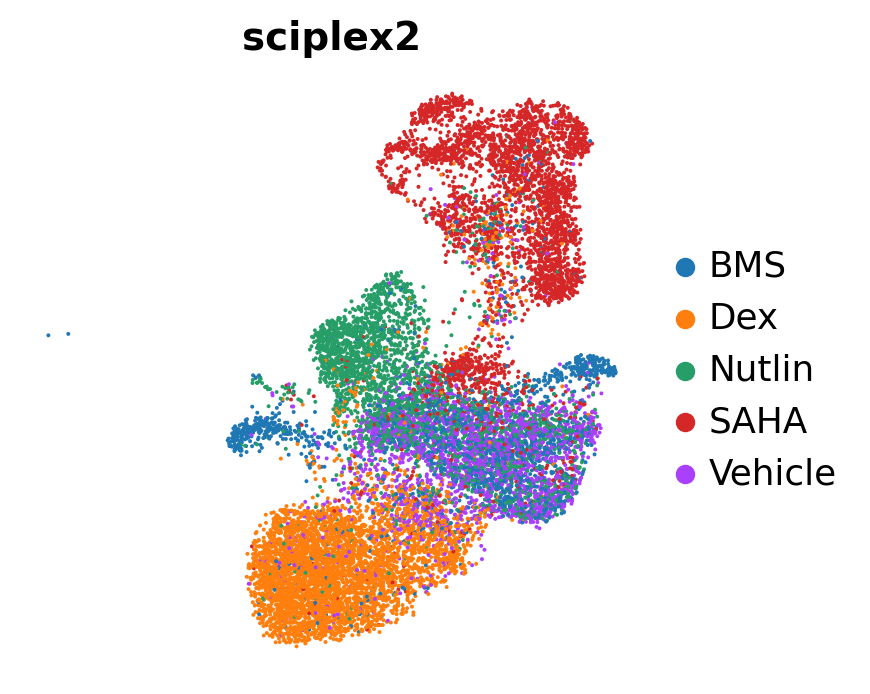

In [4]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata, color='condition', show=False, ax=ax)
ax.set_title('sciplex2', fontweight='bold')
fig.savefig('figures/suppfig_sciplex2/umap.png', dpi=600, bbox_inches='tight')

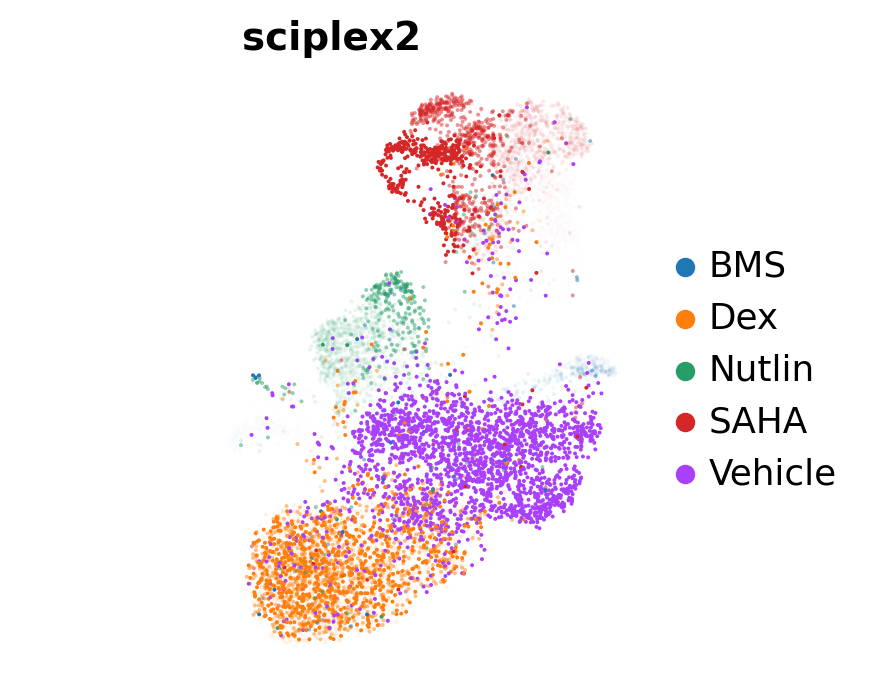

In [5]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata, color='condition', alpha=adata.obs.dose_val.astype('float64'), show=False, ax=ax)
ax.set_title('sciplex2', fontweight='bold')
fig.savefig('figures/suppfig_sciplex2/umap_dosage.png', dpi=600, bbox_inches='tight')

In [68]:
cpa_api = cpa.api.API(
    adata, 
    device='cuda', 
    perturbation_key='condition',
    covariate_keys=['cell_type'],
    dose_key='dose_val',
    split_key='split',
    doser_type='logsigm',
    save_dir=os.getcwd(),
    hparams={
        'autoencoder_depth': 2,
        'autoencoder_width': 128,
        'adversary_depth': 2,
    },
)

In [4]:
cpa_api = cpa.api.API(
    adata,
    pretrained='./sciplex2.pt', 
)

Loaded pretrained model from:	./sciplex2.pt


In [6]:
cpa_api = cpa.api.API(
    adata,
    pretrained='./sciplex2_other.pt', 
)

Loaded pretrained model from:	./sciplex2_other.pt


In [69]:
cpa_api.train(
    max_epochs=2000, 
    checkpoint_freq=20,
    run_eval=True,
    filename='sciplex2_other.pt', 
    max_minutes=60
)

Results will be saved to the folder: /storage/groups/ml01/workspace/carlo.dedonno/cpa-reproducibility/notebooks


Rec: -1.5362, AdvPert: 0.49, AdvCov: 0.00: 100%|▉| 1999/2000 [19:21<00:00,  1.72

Model saved to: /storage/groups/ml01/workspace/carlo.dedonno/cpa-reproducibility/notebookssciplex2_other.pt
{'ellapsed_minutes': 19.231869947910308,
 'epoch': 1999,
 'evaluation_stats': {'cell_type disentanglement': 0.0,
                      'ood': [0.9190779323392534,
                              0.8173742033556065,
                              0.8167598394024294,
                              0.16047935741644553],
                      'optimal for cell_type': 1.0,
                      'optimal for perturbations': 0.2,
                      'perturbation disentanglement': 0.16428206861019135,
                      'test': [0.9561470673054203,
                               0.829674198827967,
                               0.8878998178875797,
                               0.30473546323989137],
                      'training': [0.9626807045677179,
                                   0.8440878023878462,
                                   0.9157139083924691,
                        

Model saved to: /storage/groups/ml01/workspace/carlo.dedonno/cpa-reproducibility/notebookssciplex2_other.pt


# History

Computation time: 19 min


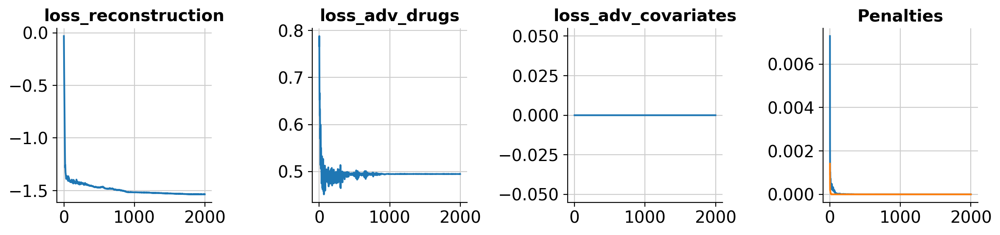

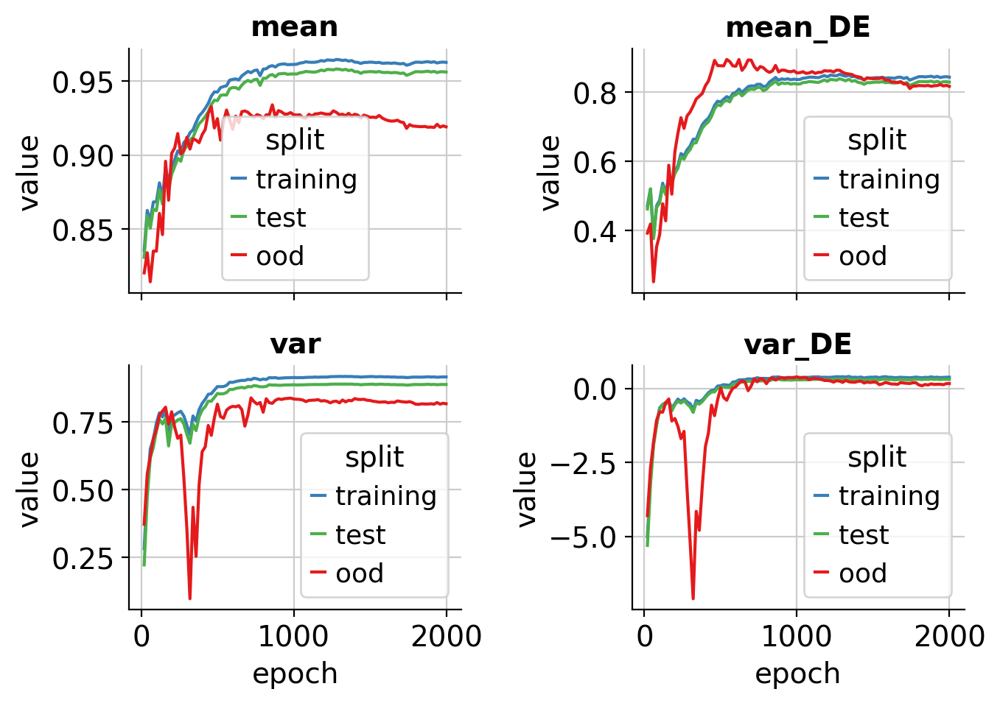

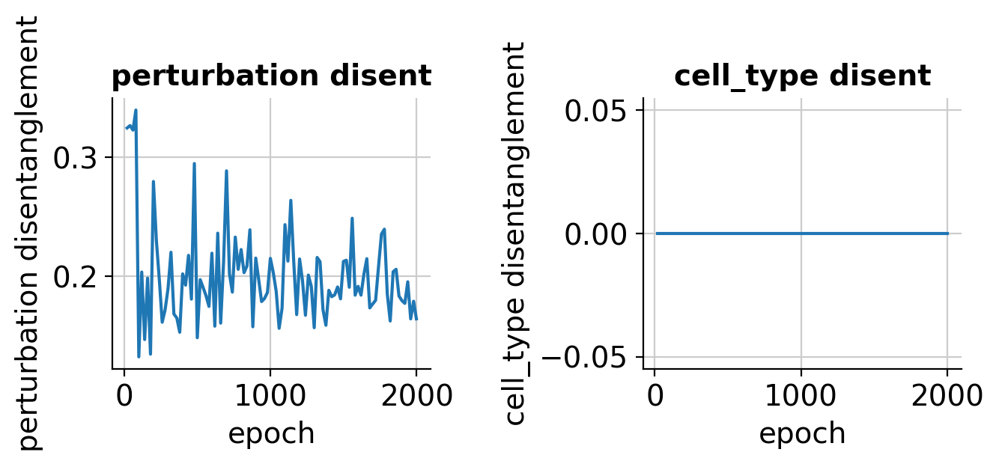

In [7]:
from cpa.plotting import CPAHistory
history = CPAHistory(cpa_api)
history.print_time()
history.plot_losses()
history.plot_r2_metrics(epoch_min=0)
history.plot_disentanglement_metrics(epoch_min=0)

In [8]:
cpa_api.num_measured_points['training']

{'A549_BMS_0.001': 442,
 'A549_BMS_0.005': 391,
 'A549_BMS_0.01': 262,
 'A549_BMS_0.05': 134,
 'A549_BMS_0.1': 103,
 'A549_BMS_1.0': 13,
 'A549_Dex_0.001': 204,
 'A549_Dex_0.005': 264,
 'A549_Dex_0.01': 479,
 'A549_Dex_0.05': 484,
 'A549_Dex_0.1': 486,
 'A549_Dex_1.0': 568,
 'A549_Nutlin_0.001': 284,
 'A549_Nutlin_0.005': 252,
 'A549_Nutlin_0.01': 387,
 'A549_Nutlin_0.05': 350,
 'A549_Nutlin_0.1': 457,
 'A549_Nutlin_1.0': 6,
 'A549_SAHA_0.001': 392,
 'A549_SAHA_0.005': 376,
 'A549_SAHA_0.01': 383,
 'A549_SAHA_0.05': 299,
 'A549_SAHA_0.1': 297,
 'A549_SAHA_1.0': 282,
 'A549_Vehicle_1.0': 1535}

Print and plot drug embeddings.

In [9]:
perts_anndata = cpa_api.get_drug_embeddings()
covars_anndata = cpa_api.get_covars_embeddings(covars_tgt='cell_type')

In [10]:
from cpa.plotting import CPAVisuals
cpa_plots = CPAVisuals(cpa_api)

In [11]:
plt.rcParams['figure.dpi'] = 600

Saved file to: figures/suppfig_sciplex2/pert_embedding.png
Saved file to: figures/suppfig_sciplex2/pert_embedding_similarity.png


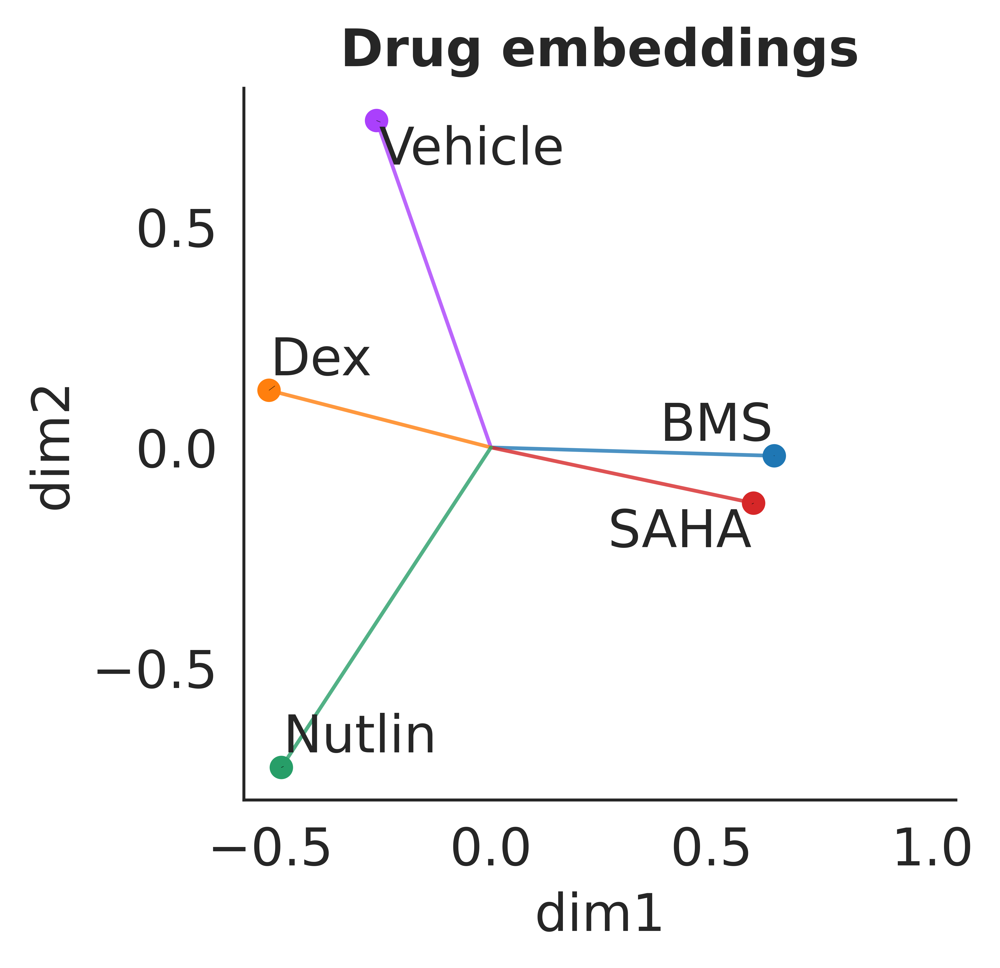

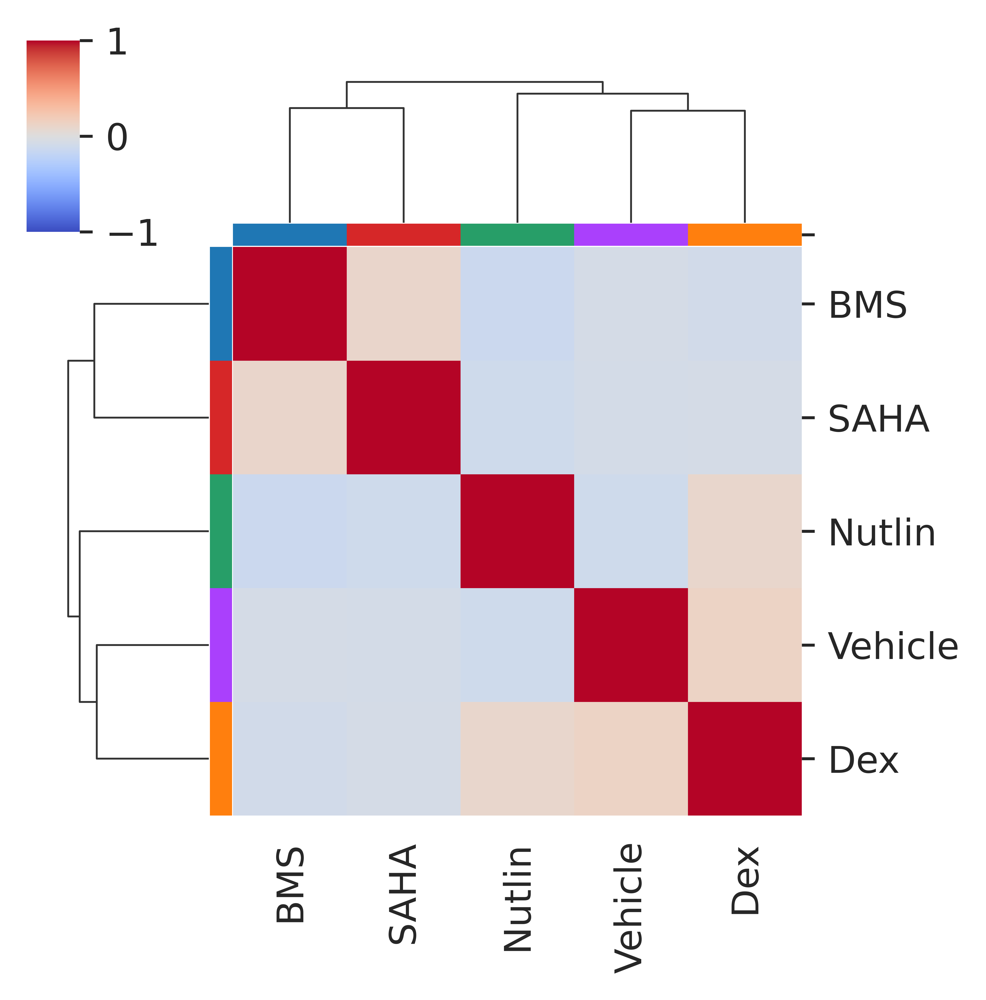

In [12]:
#perts_palette = {'BMS': '#999999',                 
#                 'SAHA': '#4daf4a',
#                 'Dex': '#377eb8',
#                 'Nutlin': '#e41a1c',
#                 'Vehicle': '#000000'    
#                }
conds = adata.obs.condition.cat.categories
perts_palette = {conds[i]: adata.uns['condition_colors'][i] for i in range(len(conds))}

cpa_plots.perts_palette = perts_palette
cpa_plots.plot_latent_embeddings(
    cpa_api.emb_perts, 
    kind='perturbations', 
    show_text=True,
    titlename='Drug embeddings',
    filename='figures/suppfig_sciplex2/pert_embedding.png'
)

In [13]:
latent_response = cpa_api.latent_dose_response(perturbations=None)

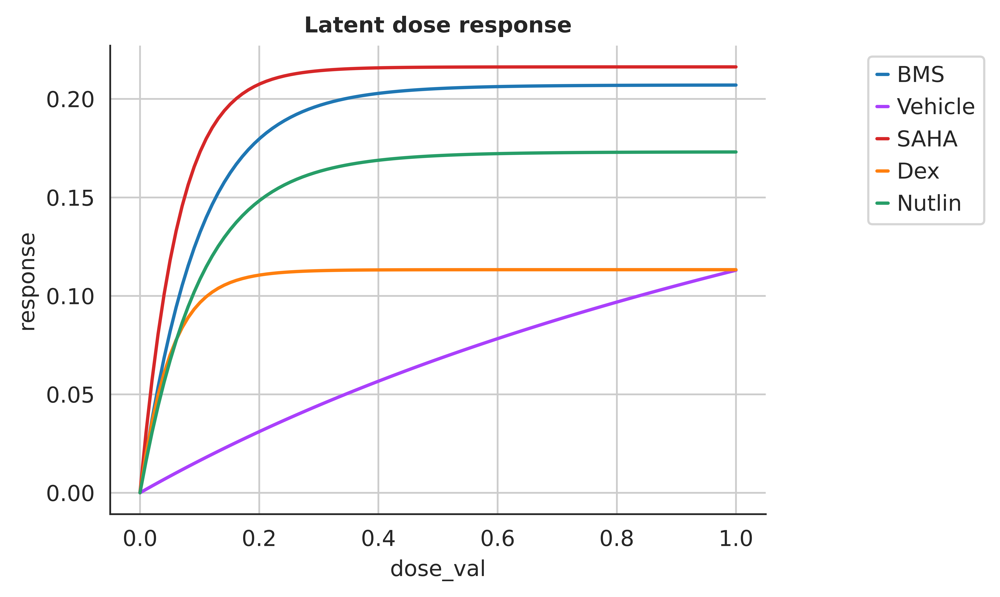

In [14]:
cpa_plots.plot_contvar_response(
    latent_response, 
    postfix='latent',    
    var_name=cpa_api.perturbation_key,
    title_name='Latent dose response'
)

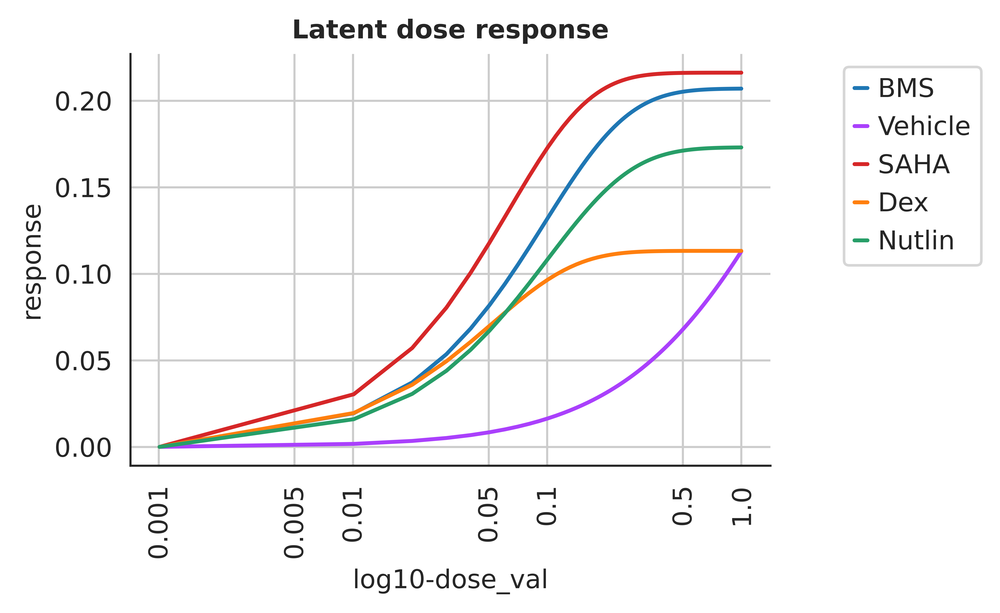

In [15]:
cpa_plots.plot_contvar_response(
    latent_response, 
    postfix='latent',    
    var_name=cpa_api.perturbation_key,
    logdose=True,
    measured_points=cpa_api.measured_points['all']['A549']['BMS'],
    title_name='Latent dose response',
    figsize=(6, 3.5),
    filename='figures/suppfig_sciplex2/latent_dose_reponse'
)

Saved file to: figures/suppfig_sciplex2/comb_latent_dose_reponse.pdf


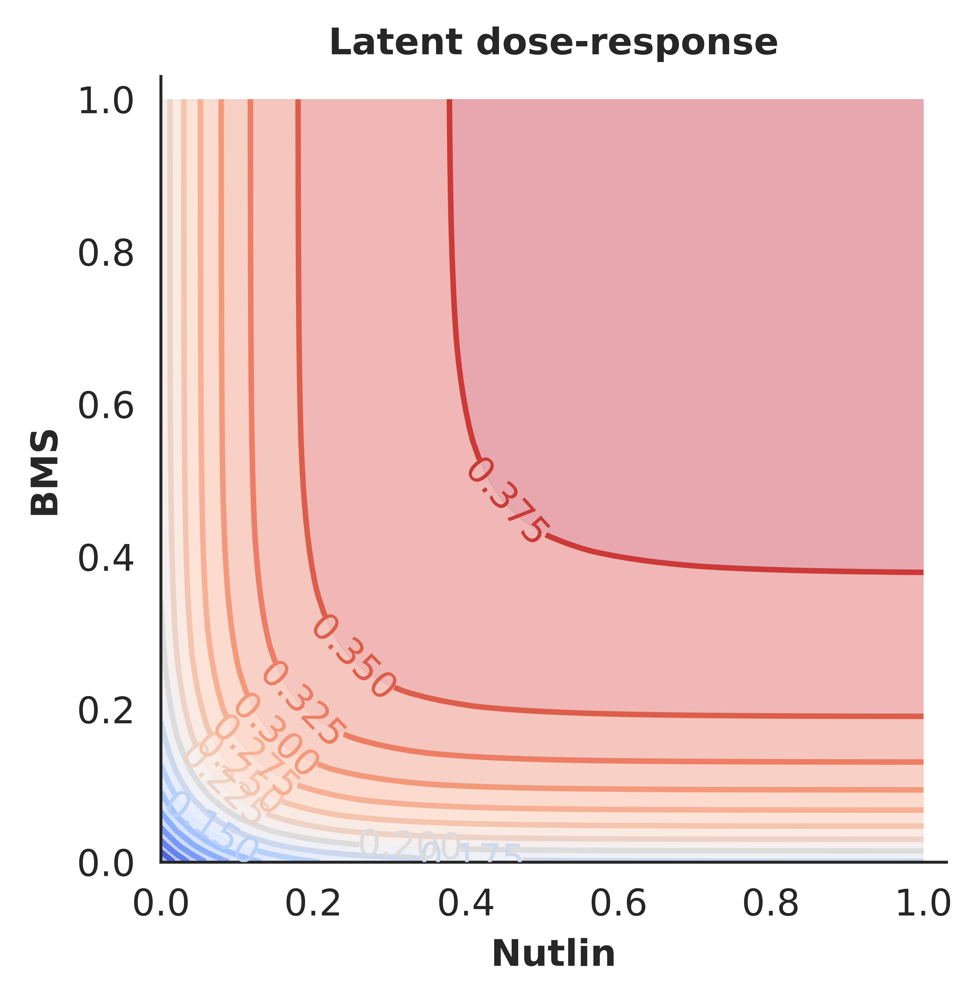

In [16]:
perturbations_pair = ['Nutlin', 'BMS']
latent_dose_2D = cpa_api.latent_dose_response2D(
    perturbations_pair, 
    n_points=50
)
cpa_plots.plot_contvar_response2D(
    latent_dose_2D, 
    title_name='Latent dose-response',
    filename='figures/suppfig_sciplex2/comb_latent_dose_reponse'
)


Saved file to: figures/suppfig_sciplex2/comb_response_MDM2.png
CPU times: user 8.33 s, sys: 591 ms, total: 8.92 s
Wall time: 2.74 s


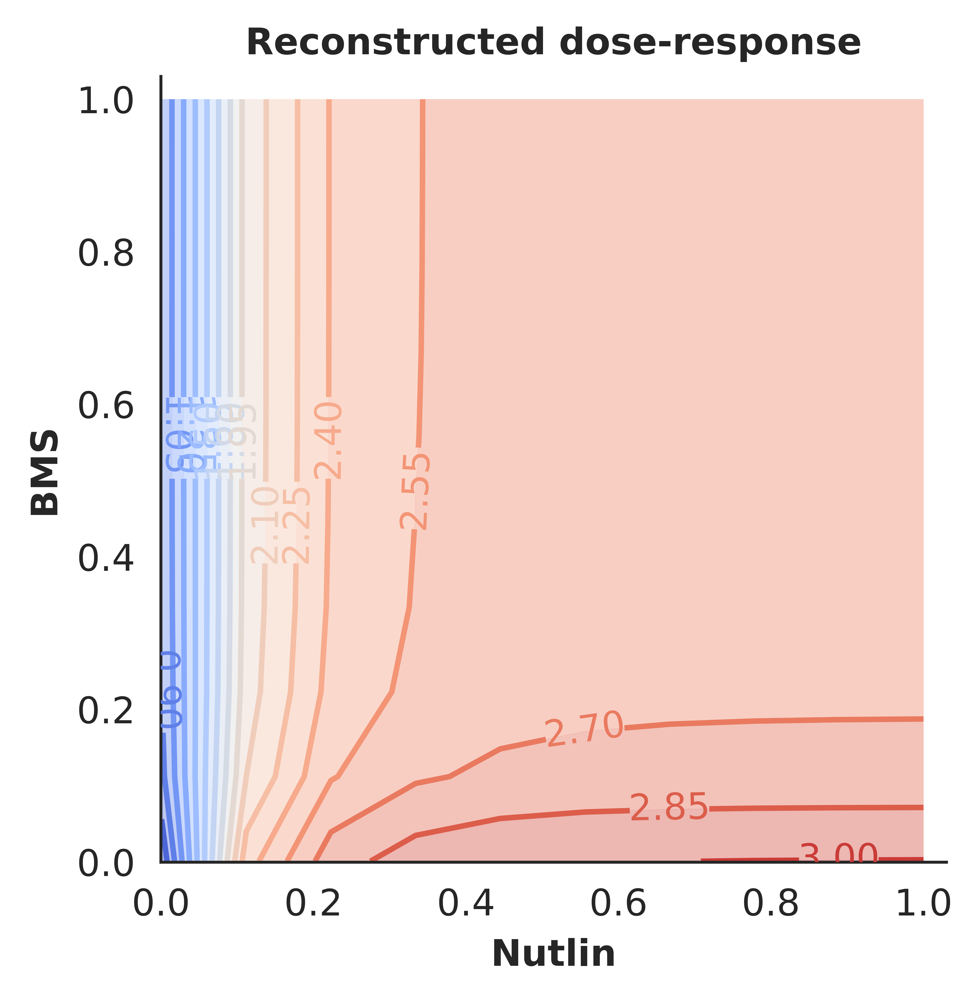

In [17]:
%%time
reconstructed_response2D = cpa_api.get_response2D(
    perturbations_pair, 
    cpa_api.unique_covars,
)
cpa_plots.plot_contvar_response2D(
    reconstructed_response2D, 
    title_name='Reconstructed dose-response',
    response_name='MDM2',
    logdose=False, 
    filename='figures/suppfig_sciplex2/comb_response_MDM2.png'
)

If you want to plot in on a log scale, you can just log values in the data frame.

In [113]:
# %%time
df_reference = cpa_api.get_response_reference()        

In [115]:
# %%time
reconstructed_response = cpa_api.get_response(
    contvar_min=0.001,
    contvar_max=1,
    n_points=100
)

{'cell_type': ['A549']}


In [118]:
adata.uns['rank_genes_groups_cov'][f'A549_Nutlin_0.5'][:10]

array(['MDM2', 'CDKN1A', 'FDXR', 'GDF15', 'TP53I3', 'PDE4D', 'FAM129A',
       'SQSTM1', 'TNFRSF10B', 'LINC01021'], dtype=object)

For example we can take of the top 50 DE genes for Nutlin - MDM2. MDM2 is itself transcriptionally-regulated by p53. And p53 is the target of Nutlin. Therefore, we expect our model to learn it.

We can also look at this plot on the log10-scale. It makes sense for this dataset, because the measured doses were not evenly distributed.

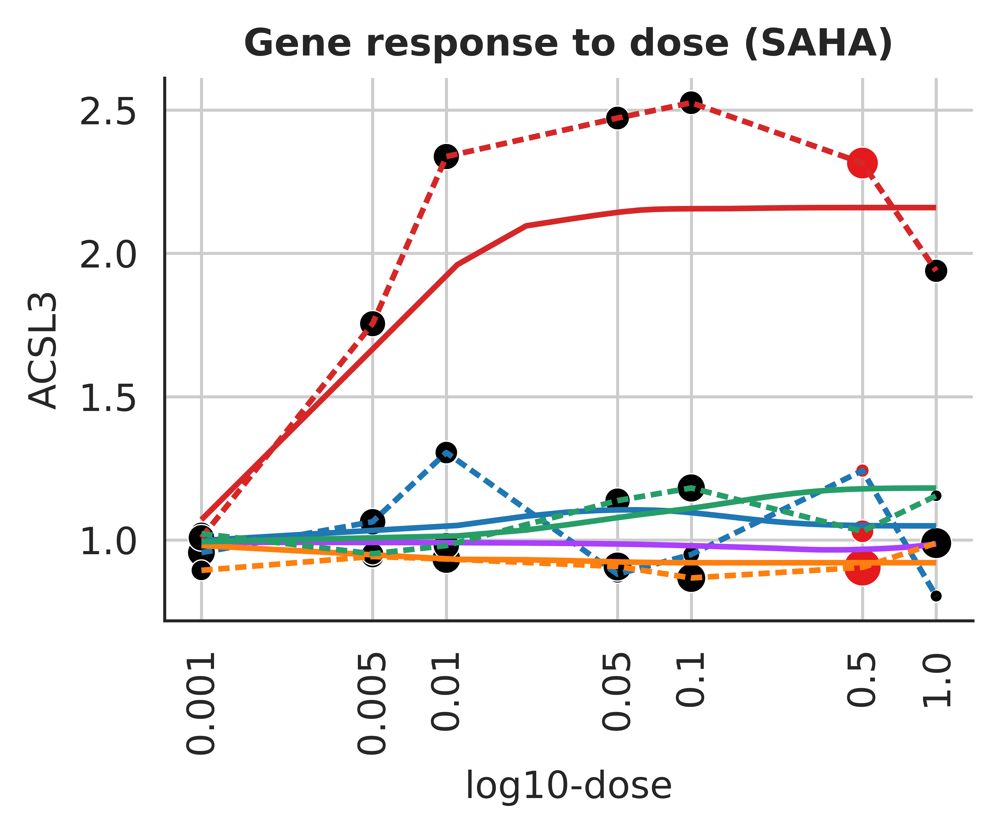

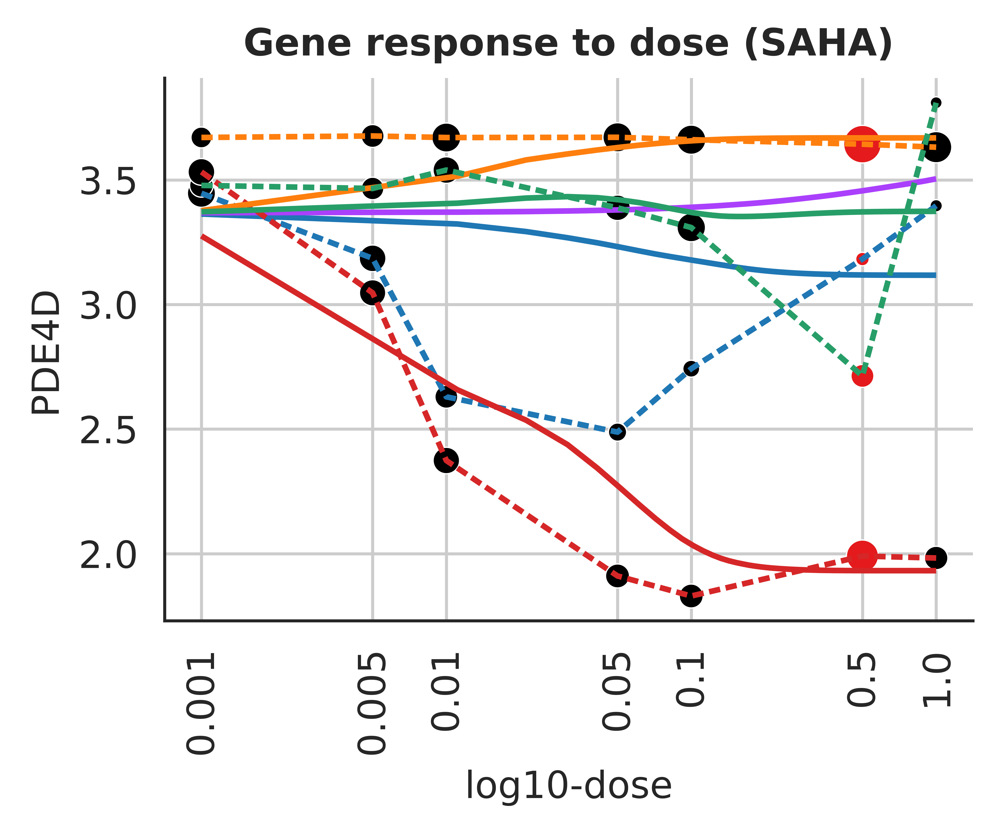

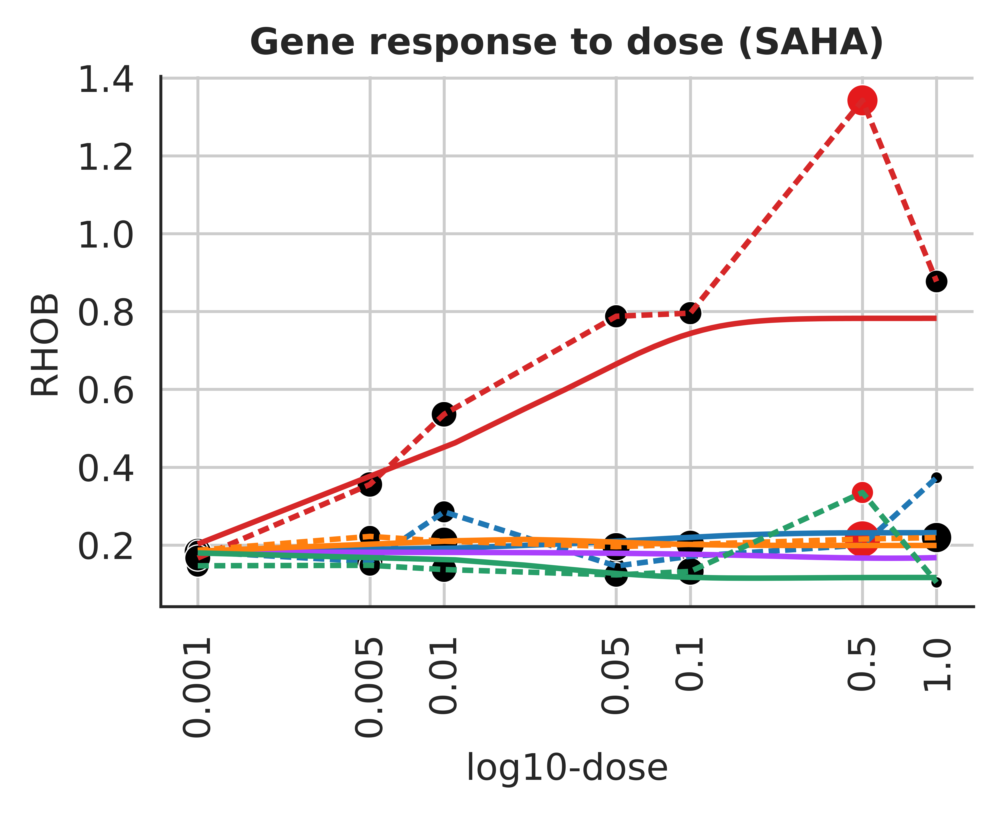

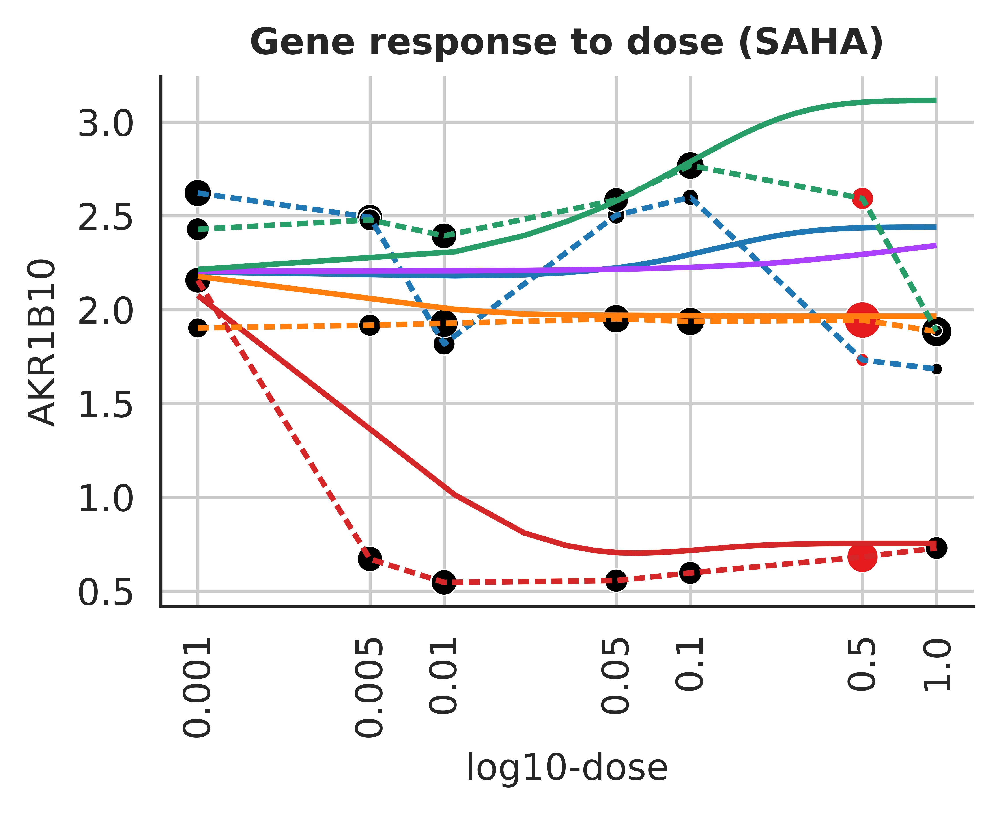

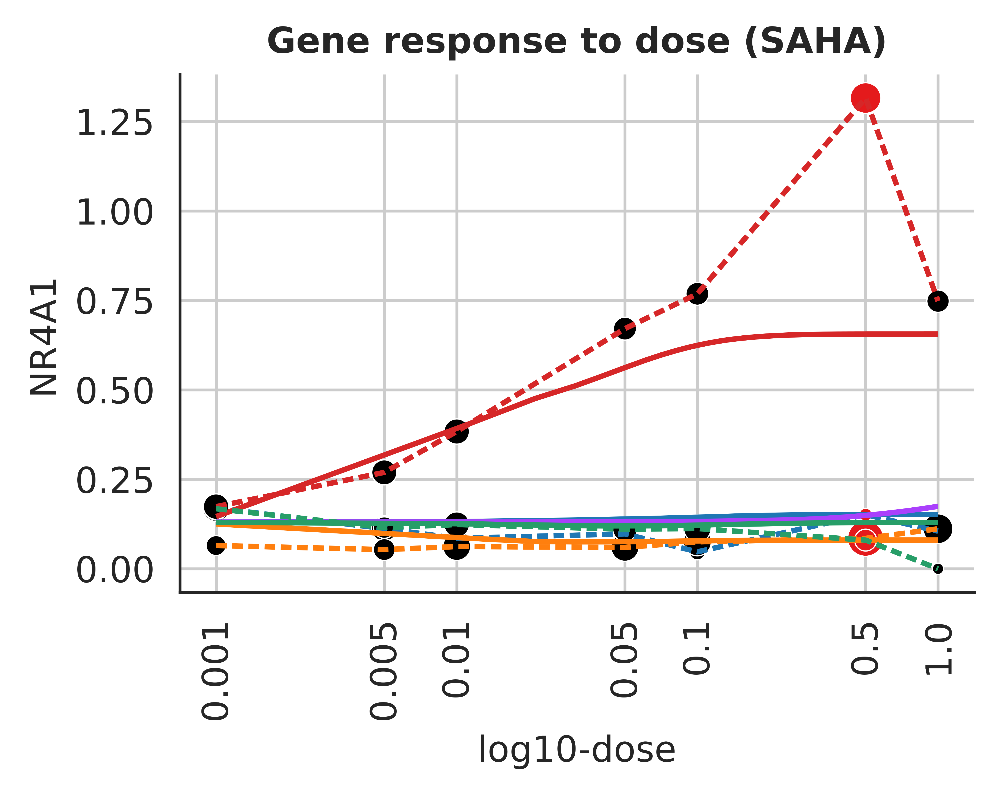

...

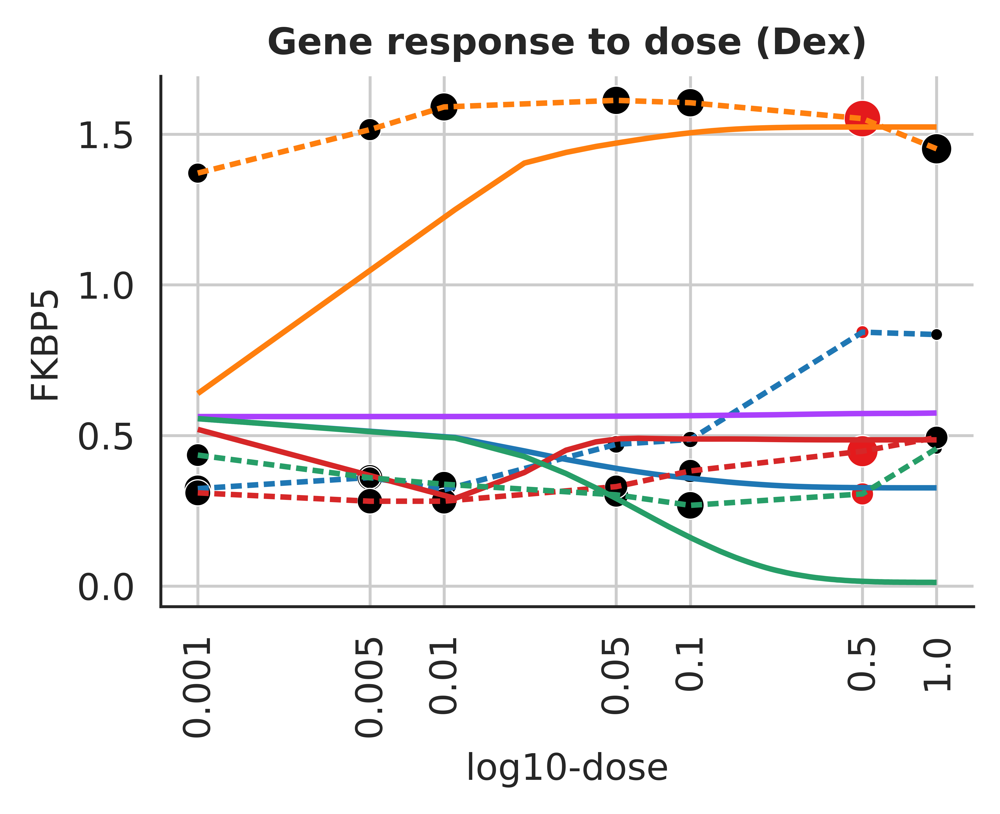

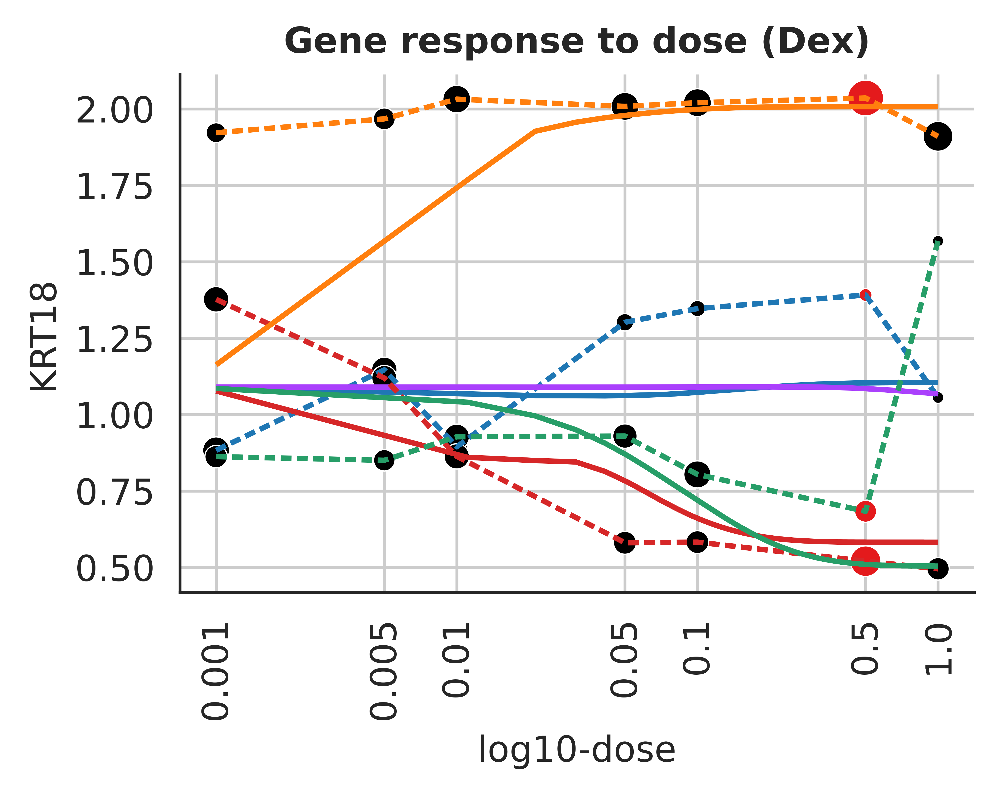

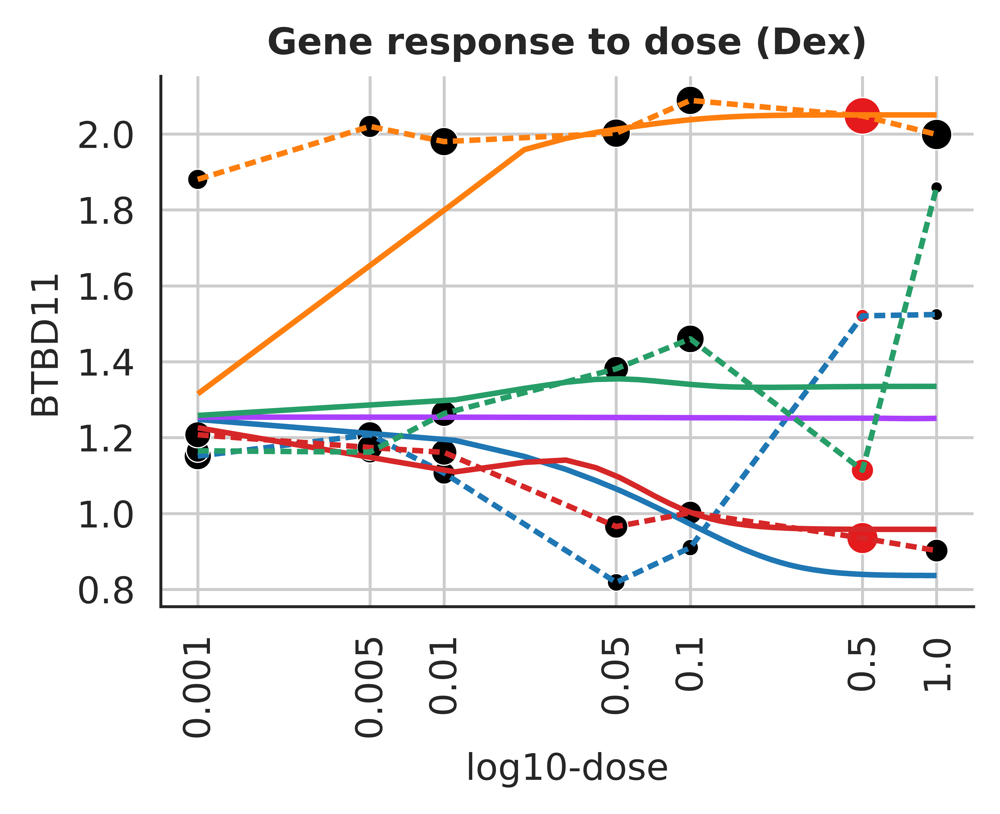

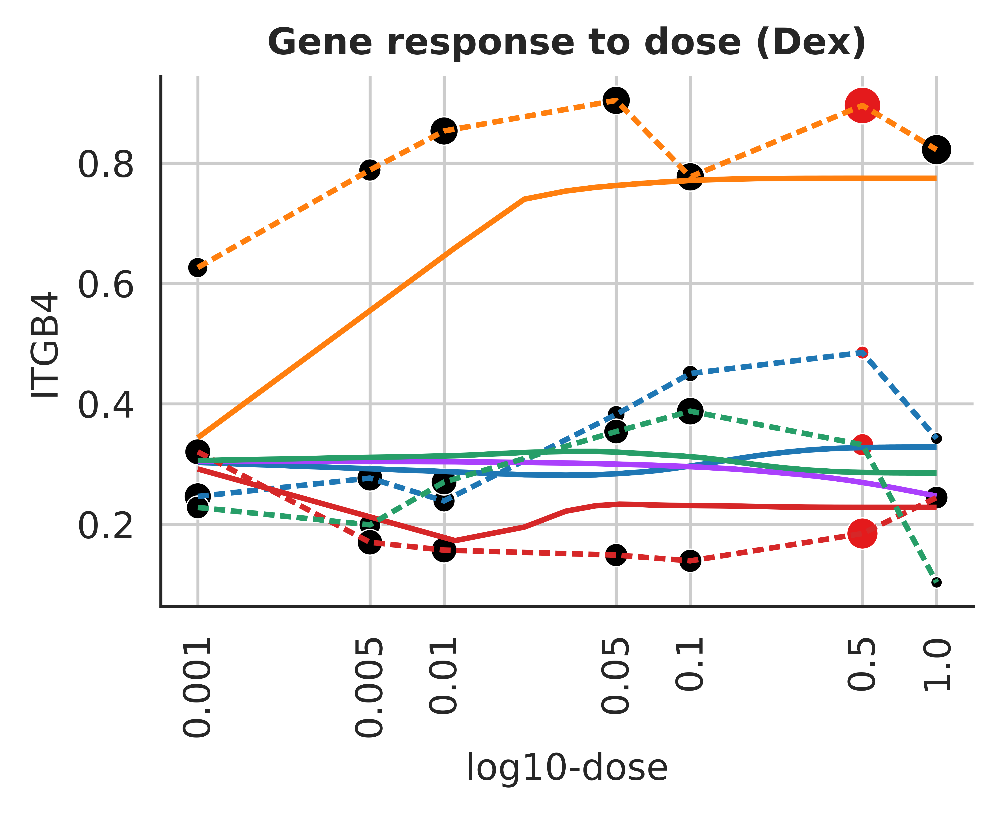

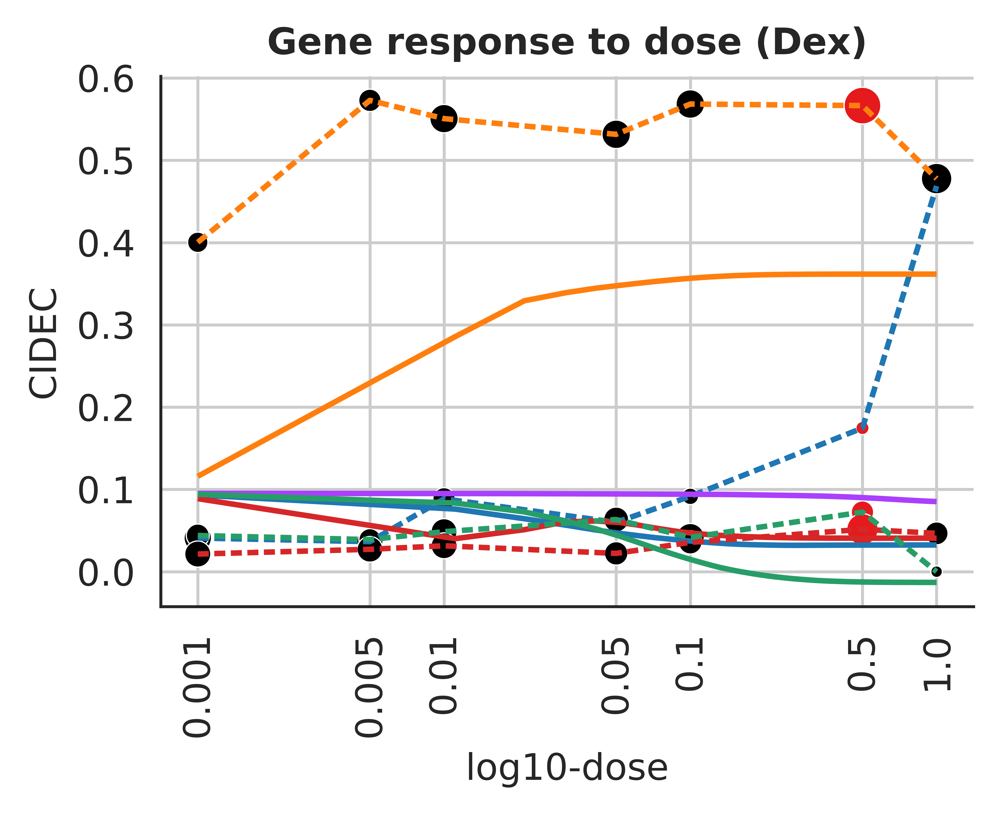

In [116]:
for pert in ['SAHA', 'Nutlin', 'BMS', 'Dex']:
    top_degs = adata.uns['rank_genes_groups_cov'][f'A549_{pert}_0.5'][:5]
    for i, gene in enumerate(top_degs):
        cpa_plots.plot_contvar_response(
            reconstructed_response, 
            df_ref=df_reference, 
            postfix='reconstructed',
            figsize=(4, 3.3),
            bbox=(1.6, 1.),
            response_name=gene,
            xlabelname='log10-dose',
            logdose=True,
            palette=cpa_plots.perts_palette,
            measured_points=cpa_api.measured_points['all']['A549']['BMS'],
            var_name=cpa_api.perturbation_key,
            title_name=f'Gene response to dose ({pert})',
            filename=f'figures/suppfig_sciplex2_dose/doseresponse_{pert}_{i}_{gene}.png'
        )

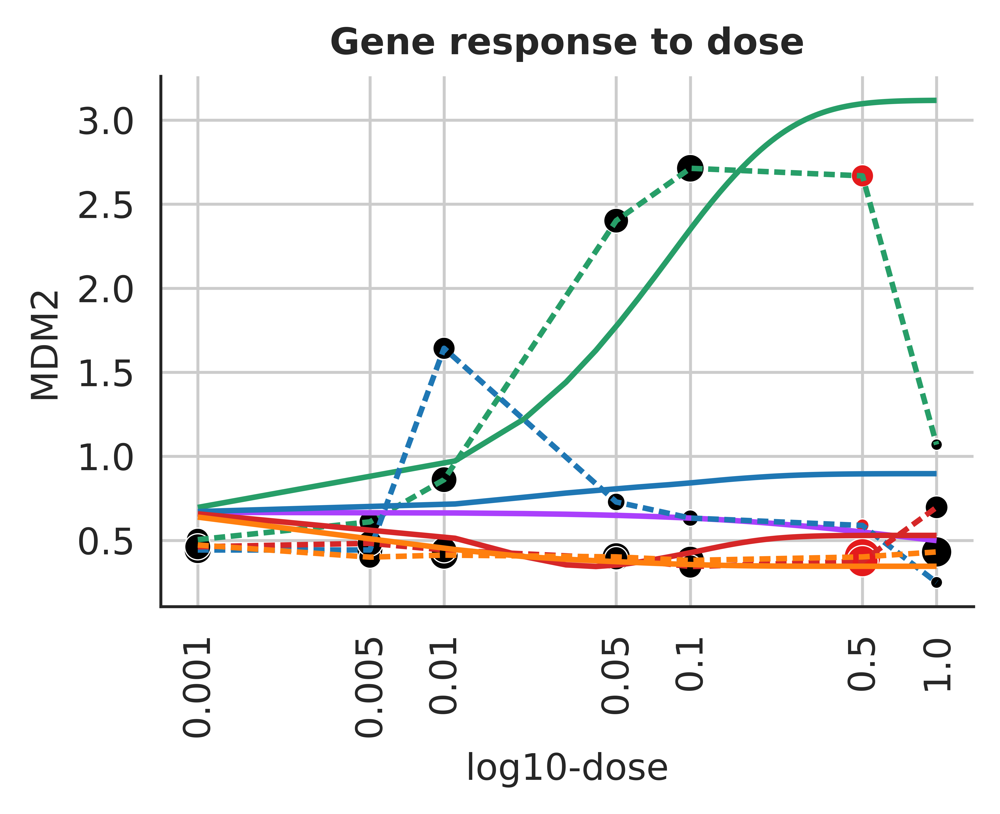

In [21]:
cpa_plots.plot_contvar_response(
    reconstructed_response, 
    df_ref=df_reference, 
    postfix='reconstructed',
    figsize=(4, 3.3),
    bbox=(1.6, 1.),
    response_name='MDM2',
    xlabelname='log10-dose',
    logdose=True,
    palette=cpa_plots.perts_palette,
    measured_points=cpa_api.measured_points['all']['A549']['BMS'],
    var_name=cpa_api.perturbation_key,
    title_name='Gene response to dose',
    filename='figures/suppfig_sciplex2/MDM2_dose.png'
)

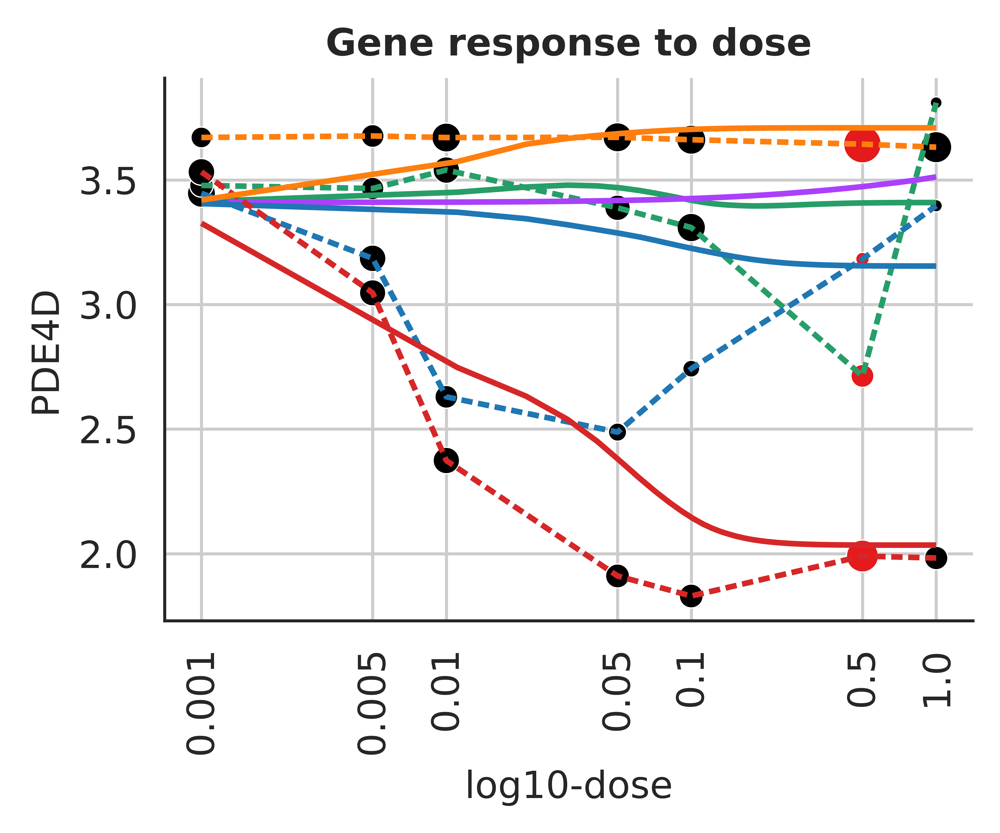

In [22]:
cpa_plots.plot_contvar_response(
    reconstructed_response, 
    df_ref=df_reference, 
    postfix='reconstructed',
    figsize=(4, 3.3),
    bbox=(1.6, 1.),
    response_name='PDE4D',
    xlabelname='log10-dose',
    logdose=True,
    palette=cpa_plots.perts_palette,
    measured_points=cpa_api.measured_points['all']['A549']['BMS'],
    var_name=cpa_api.perturbation_key,
    title_name='Gene response to dose',
    filename='figures/suppfig_sciplex2/PDE4D_dose.png'
)

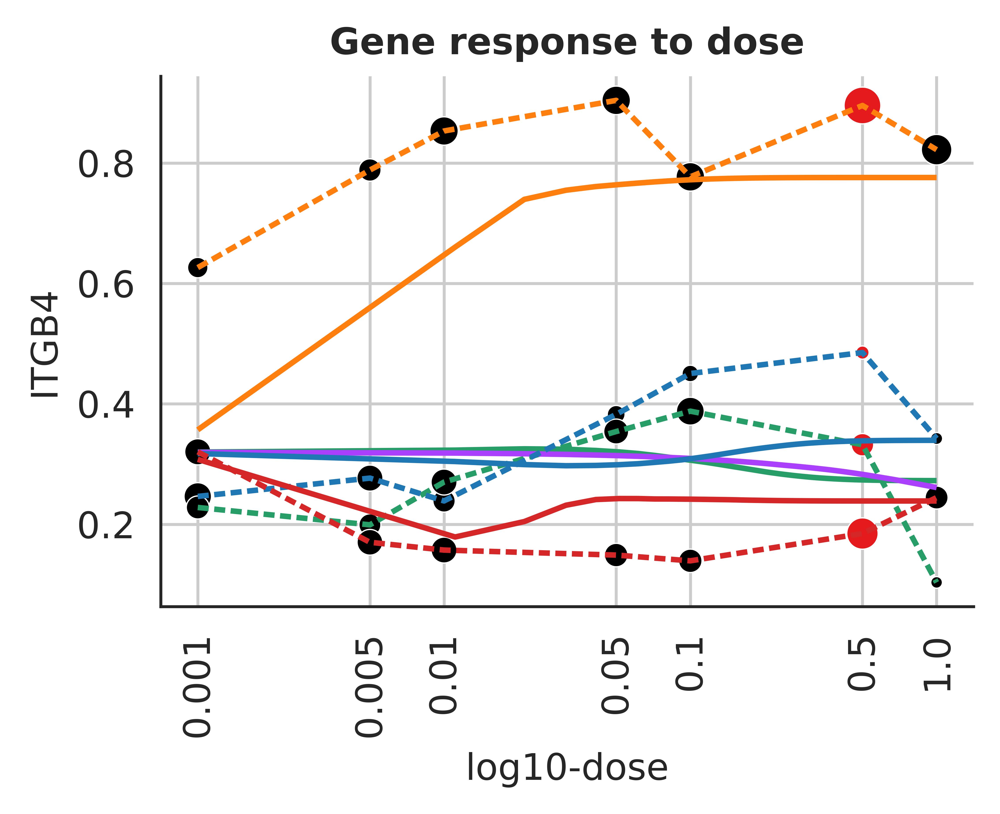

In [23]:
cpa_plots.plot_contvar_response(
    reconstructed_response, 
    df_ref=df_reference, 
    postfix='reconstructed',
    figsize=(4, 3.3),
    bbox=(1.6, 1.),
    response_name='ITGB4',
    xlabelname='log10-dose',
    logdose=True,
    palette=cpa_plots.perts_palette,
    measured_points=cpa_api.measured_points['all']['A549']['BMS'],
    var_name=cpa_api.perturbation_key,
    title_name='Gene response to dose',
    filename='figures/suppfig_sciplex2/ITGB4_dose.png'
)

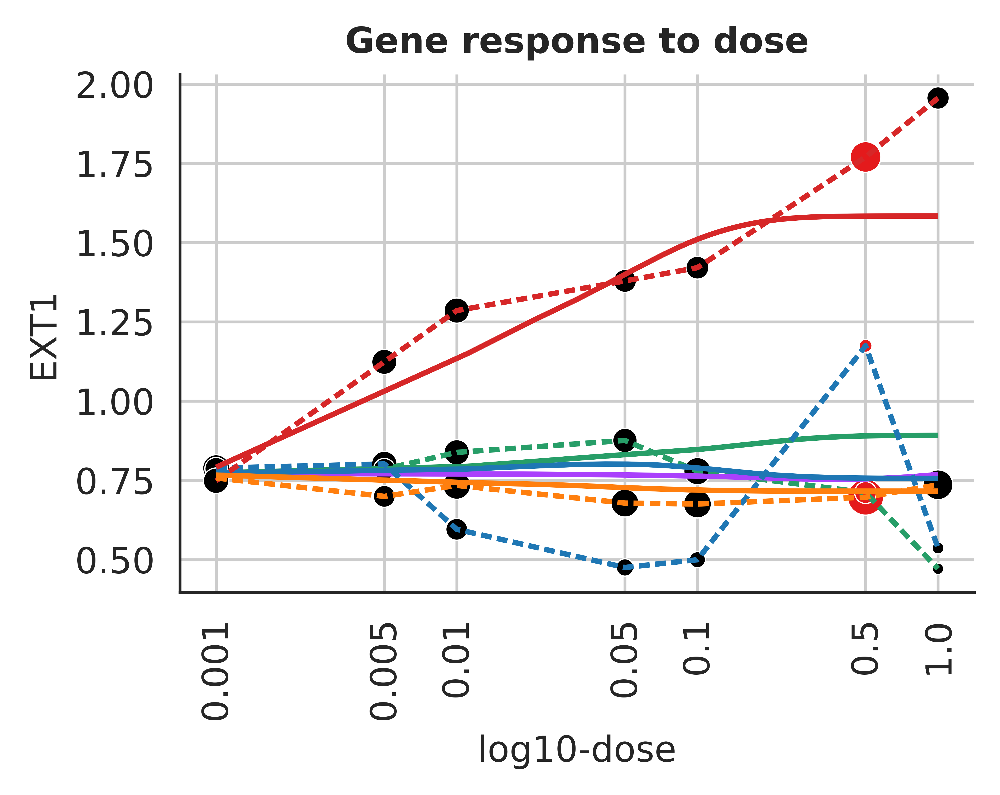

In [24]:
cpa_plots.plot_contvar_response(
    reconstructed_response, 
    df_ref=df_reference, 
    postfix='reconstructed',
    figsize=(4, 3.3),
    bbox=(1.6, 1.),
    response_name='EXT1',
    xlabelname='log10-dose',
    logdose=True,
    palette=cpa_plots.perts_palette,
    measured_points=cpa_api.measured_points['all']['A549']['BMS'],
    var_name=cpa_api.perturbation_key,
    title_name='Gene response to dose',
    filename='figures/suppfig_sciplex2/EXT1_dose.png'
)

# Predictions

In [25]:
print('Perturbations:', cpa_api.unique_perts)
print('Covariates:', cpa_api.unique_covars)
print('Datasets splits:', cpa_api.datasets.keys())

Perturbations: ['Nutlin', 'Vehicle', 'BMS', 'SAHA', 'Dex']
Covariates: {'cell_type': ['A549']}
Datasets splits: dict_keys(['training', 'test', 'ood'])


# Evaluation

In [69]:
adata_random = sc.pp.subsample(adata, n_obs=1000, copy=True)

In [89]:
genes_control = cpa_api.datasets['training'].subset_condition(control=True).genes
df_train = cpa_api.evaluate_r2(cpa_api.datasets['training'].subset_condition(control=False), genes_control, adata_random.X.A)

In [90]:
genes_control = cpa_api.datasets['test'].subset_condition(control=True).genes
df_ood = cpa_api.evaluate_r2(cpa_api.datasets['ood'], genes_control, adata_random.X.A)

In [91]:
genes_control = cpa_api.datasets['test'].subset_condition(control=True).genes
df_test = cpa_api.evaluate_r2(cpa_api.datasets['test'].subset_condition(control=False), genes_control, adata_random.X.A)

In [92]:
df_ood['split'] = 'ood'
df_test['split'] ='test'
df_train['split'] ='train'

In [93]:
df_score = pd.concat([df_test, df_ood])
df_score.round(2).sort_values(by=['condition', 'R2_mean', 'R2_mean_DE'], ascending=False)

,cell_type,condition,dose_val,R2_mean,R2_mean_DE,R2_var,R2_var_DE,model,num_cells,split
36,A549,SAHA,0.001,0.97,0.94,0.91,0.45,cpa,169,test
6,A549,SAHA,0.5,0.97,0.85,0.92,0.65,cpa,604,ood
37,A549,SAHA,0.001,0.96,0.94,0.77,0.07,baseline,169,test
40,A549,SAHA,0.01,0.96,0.90,0.93,0.85,cpa,160,test
42,A549,SAHA,0.05,0.95,0.81,0.88,0.71,cpa,118,test
38,A549,SAHA,0.005,0.94,0.85,0.90,0.64,cpa,143,test
46,A549,SAHA,1.0,0.94,0.77,0.85,0.64,cpa,137,test
44,A549,SAHA,0.1,0.94,0.74,0.89,0.81,cpa,129,test
39,A549,SAHA,0.005,0.87,0.69,0.66,-0.34,baseline,143,test
41,A549,SAHA,0.01,0.80,0.43,0.53,-0.57,baseline,160,test


In [84]:
df_plot = pd.melt(df_score, id_vars=['cell_type', 'condition', 'split', 'model'])

In [94]:
df_plot = df_ood.melt(id_vars=['cell_type', 'condition', 'dose_val', 'model', 'num_cells', 'split'])

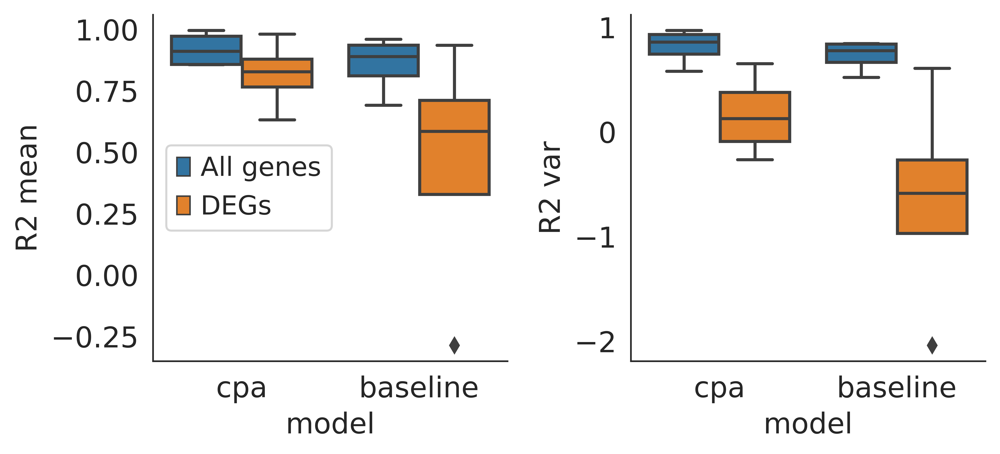

In [111]:
fig, ax = plt.subplots(1, 2, figsize=(7, 3.3))
sns.boxplot(x='model', y='value', hue='variable', data=df_plot[df_plot.variable.str.contains('mean')], ax=ax[0])
sns.boxplot(x='model', y='value', hue='variable', data=df_plot[df_plot.variable.str.contains('var')], ax=ax[1])
ax[0].set_xlabel('model')
ax[1].set_xlabel('model')
ax[0].set_ylabel('R2 mean')
ax[1].set_ylabel('R2 var')
handles, _ = ax[0].get_legend_handles_labels()
ax[0].legend(handles, ['All genes', 'DEGs'])
ax[1].get_legend().remove()
sns.despine()
fig.tight_layout()
fig.savefig('figures/suppfig_sciplex2/evaluation.png', dpi=600, bbox_inches='tight')

In [33]:
# cols_print = ['condition', 'dose_val','R2_mean', 'R2_mean_DE', 'R2_var', 'R2_var_DE', 'split', 'num_cells']
# df_score = df_score.round(2).sort_values(by=['condition', 'R2_mean', 'R2_mean_DE'], ascending=False)
# print(df_score[cols_print])
# # print(df_score[cols_print].to_latex(index=False))

cols_print = ['condition', 'dose_val','R2_mean', 'R2_mean_DE', 'R2_var', 'split', 'num_cells']
df_score = df_score.round(2).sort_values(by=['condition', 'R2_mean', 'R2_mean_DE', 'R2_var'], ascending=False)
df_latex = df_score[cols_print].copy()
df_latex = df_latex.replace('ood', '\textbf{ood}')
print(df_latex.to_latex(index=False, bold_rows=True, escape=False))

\begin{tabular}{llrrrlr}
\toprule
condition & dose_val &  R2_mean &  R2_mean_DE &  R2_var &        split &  num_cells \\
\midrule
     SAHA &    0.001 &     0.97 &        0.94 &    0.91 &         test &        169 \\
     SAHA &      0.5 &     0.97 &        0.85 &    0.92 & \textbf{ood} &        604 \\
     SAHA &     0.01 &     0.96 &        0.90 &    0.93 &         test &        160 \\
     SAHA &     0.05 &     0.95 &        0.81 &    0.88 &         test &        118 \\
     SAHA &    0.005 &     0.94 &        0.85 &    0.90 &         test &        143 \\
     SAHA &      1.0 &     0.94 &        0.77 &    0.85 &         test &        137 \\
     SAHA &      0.1 &     0.94 &        0.74 &    0.89 &         test &        129 \\
   Nutlin &     0.01 &     0.99 &        0.98 &    0.94 &         test &        180 \\
   Nutlin &     0.05 &     0.99 &        0.97 &    0.95 &         test &        136 \\
   Nutlin &      0.1 &     0.99 &        0.97 &    0.95 &         test &        200 \\


# Uncertainty

We can profile all the predictions with an uncertainty score.

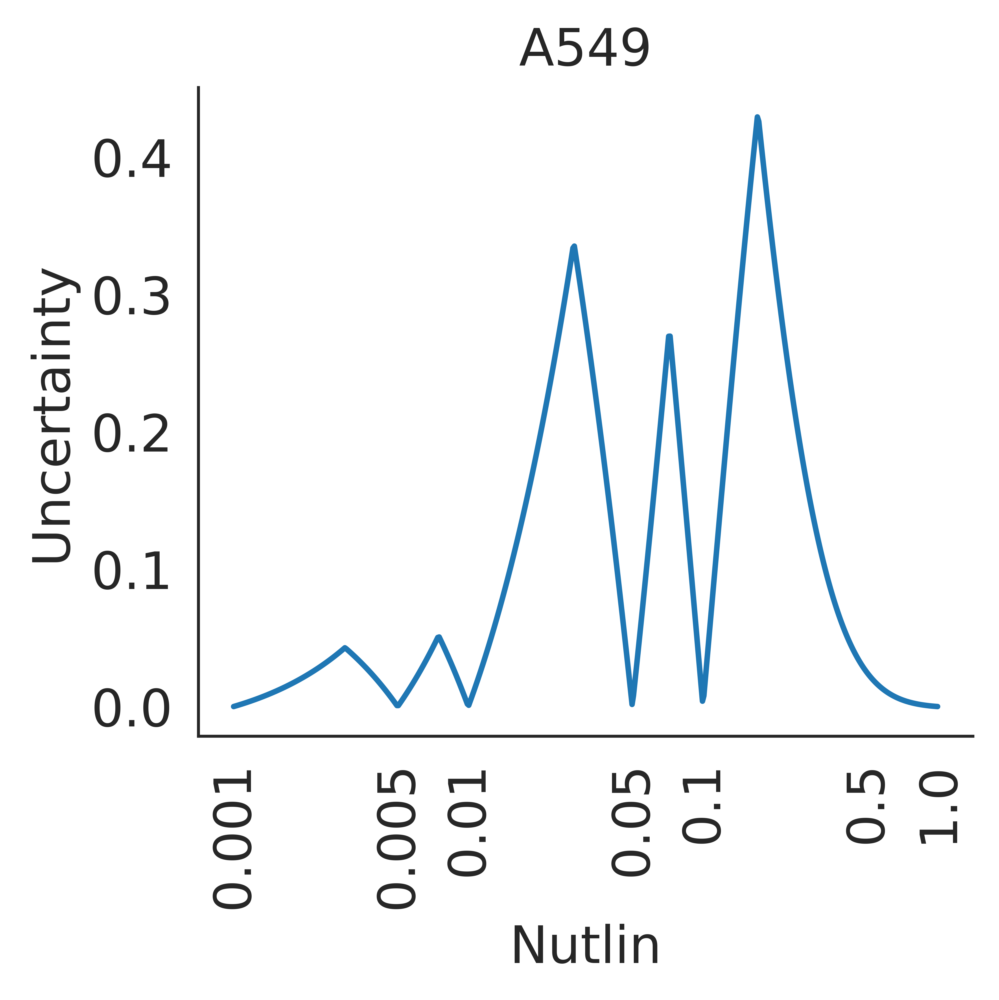

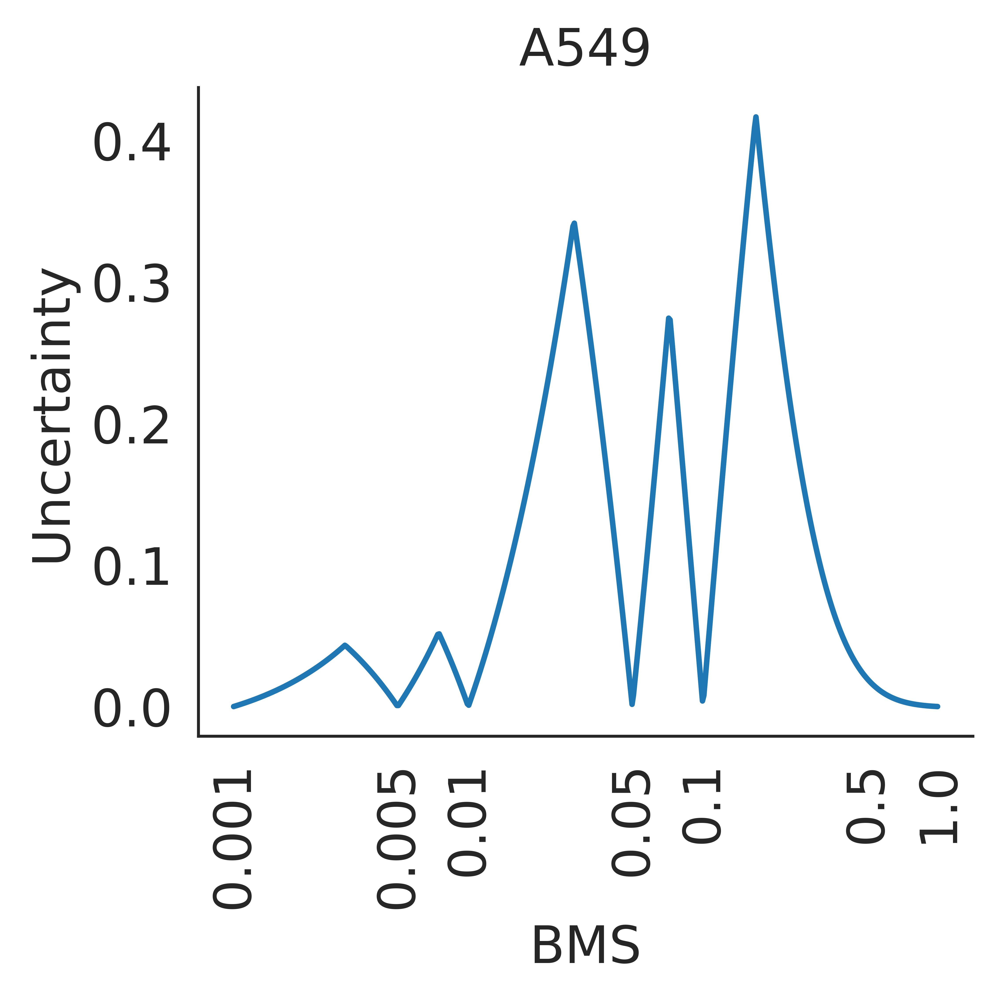

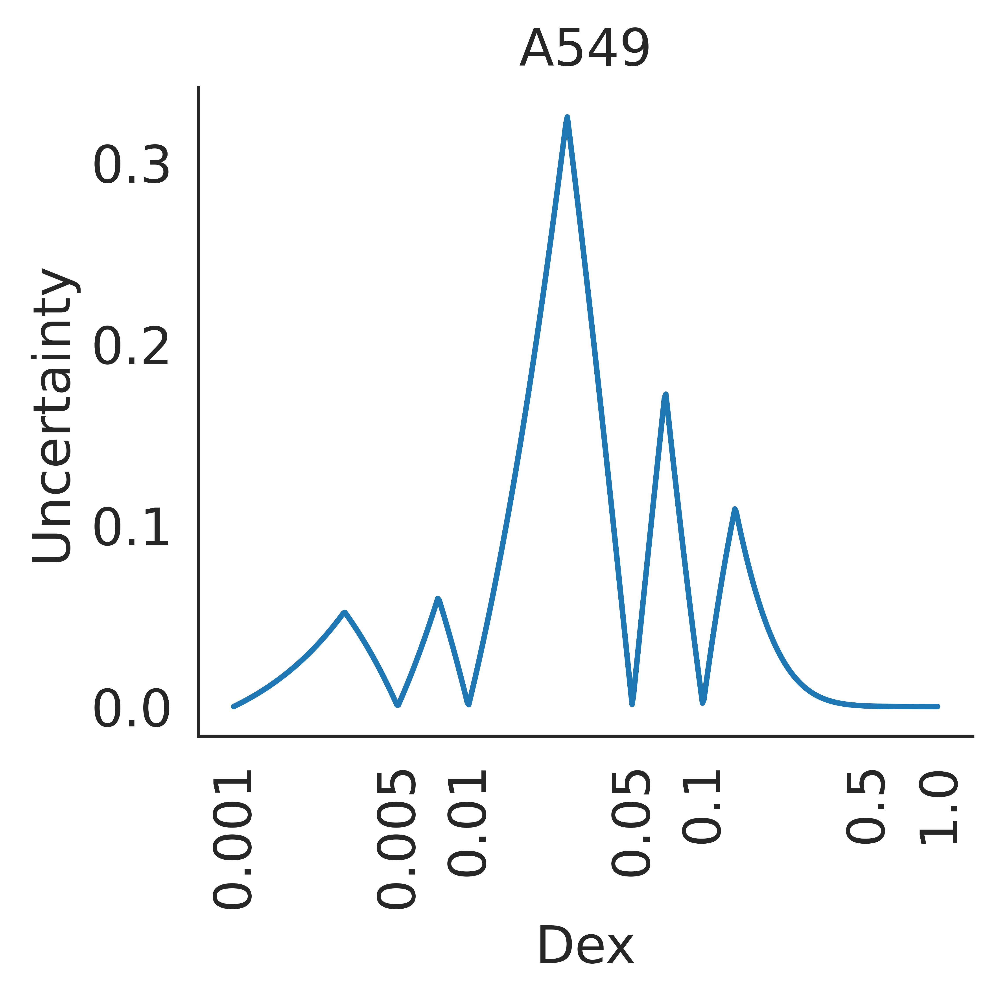

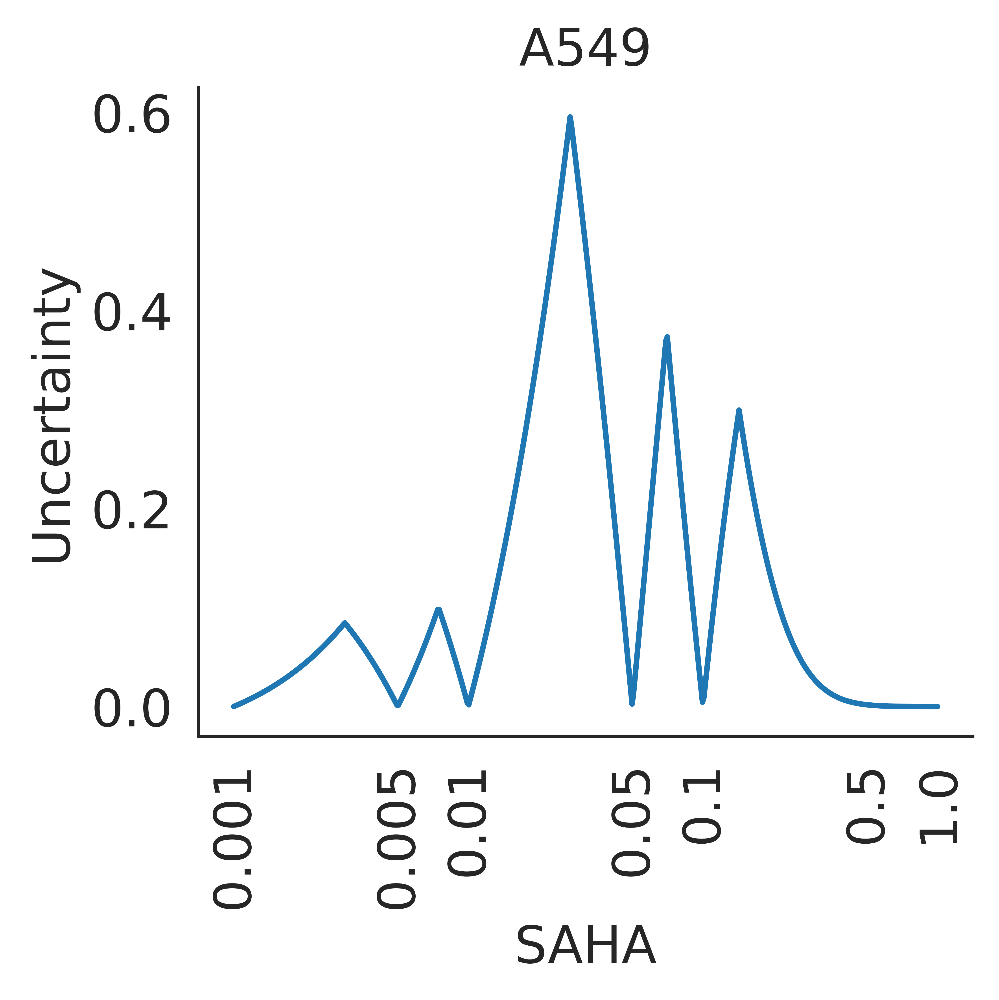

In [34]:
import cpa.plotting as pl
cpa_api.compute_comb_emb(thrh=0)
uncert_list = []
for i, drug in enumerate(['Nutlin', 'BMS', 'Dex', 'SAHA']):

    uncert_list.append(pl.plot_uncertainty_dose(
        cpa_api,
        cov={'cell_type': 'A549'},
        pert=drug,
        N=501,
        measured_points=cpa_api.measured_points['all'],
        cond_key='condition',
        log=True,
        metric='eucl'
    ))
df_uncert = pd.concat(uncert_list)


In [35]:
df_uncert = df_uncert.reset_index()

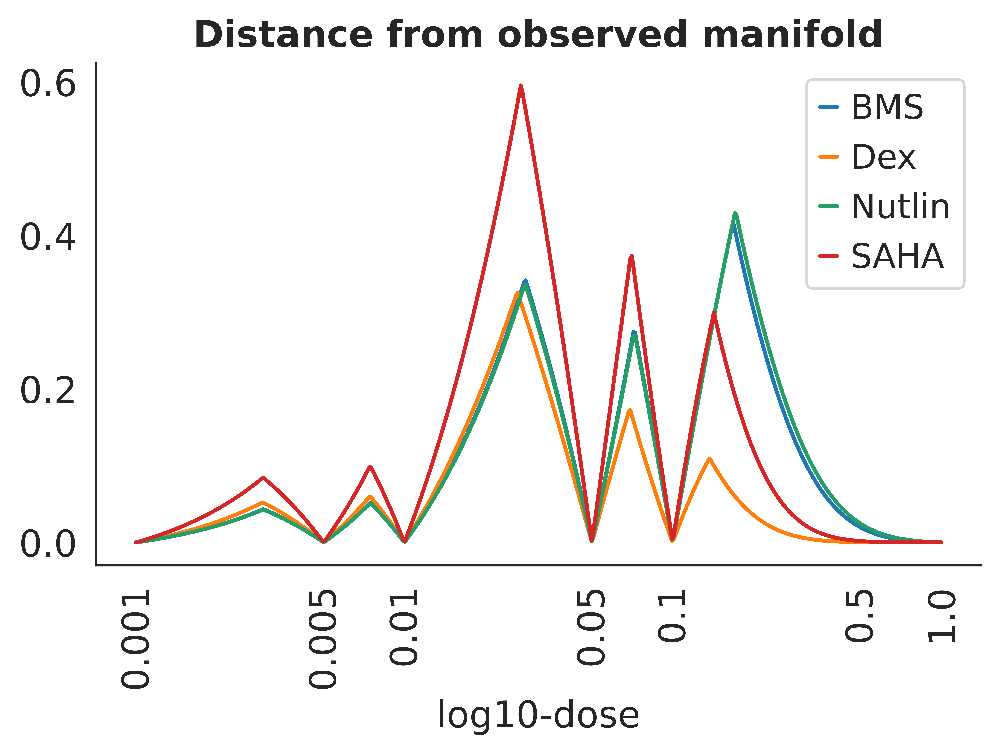

In [39]:
fig, ax = plt.subplots(1, 1, figsize=(6, 3.5))
conditions = ['BMS', 'Dex', 'Nutlin', 'SAHA']
for condition in ['BMS', 'Dex', 'Nutlin', 'SAHA']:
    x = df_uncert[df_uncert['condition']==condition]['dose_val'].astype('float32').values
    y = df_uncert[df_uncert['condition']==condition]['uncertainty_eucl'].astype('float32').values
    ax.plot(x, y, color=cpa_plots.perts_palette[condition])

ax.set_xscale('log')
ax.set_xticks([0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1.0])
ax.set_xticklabels(['0.001', '0.005', '0.01', '0.05', '0.1', '0.5', '1.0'], rotation=90)
ax.set_xlabel('log10-dose')
plt.legend(conditions)
sns.despine()
ax.set_title('Distance from observed manifold', fontweight='bold')
fig.savefig('figures/suppfig_sciplex2/uncertainty.png', dpi=600, bbox_inches='tight')

In [45]:
df_uncert[(df_uncert['condition']=='SAHA') & (df_uncert['dose_val']=='0.5011872336')]

,index,covariates,condition,dose_val,uncertainty_cosine,uncertainty_eucl,closest_cond_cos,closest_cond_eucl
1953,450,A549,SAHA,0.5011872336,0.0,0.001769,A549_SAHA_0.05,A549_SAHA_1.0


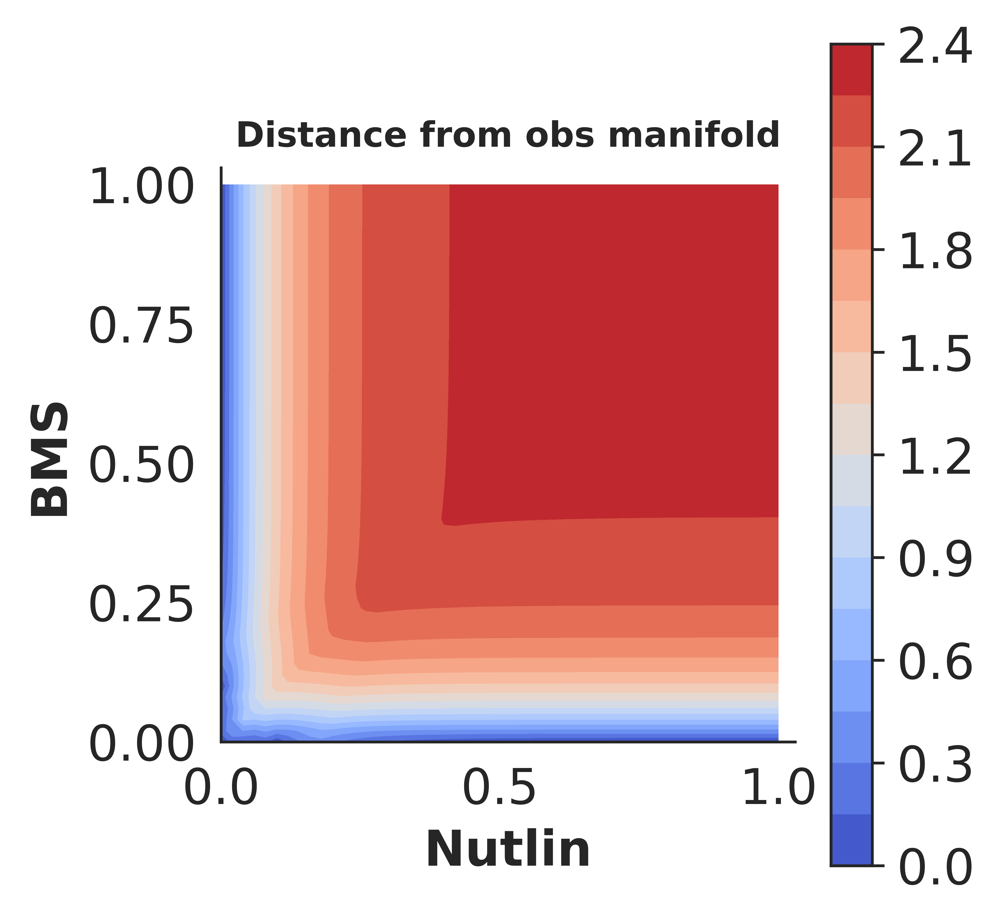

In [37]:
df_pred = pl.plot_uncertainty_comb_dose(
    cpa_api=cpa_api,
    cov={'cell_type': 'A549'},
    pert='Nutlin+BMS',
    N=51,
    metric='eucl',
    title='Distance from obs manifold',
    filename='figures/suppfig_sciplex2/uncertainty_comb.png'
)